## GFPGAN - Face Restoration GAN model
GFPGAN is a blind **face restoration algorithm** towards real-world face images. <br><br>
It leverages the generative face prior in a **pre-trained GAN (*e.g.*, StyleGAN2) to restore realistic faces while precerving fidelity.** <br>

https://github.com/TencentARC/GFPGAN

<img src="https://github.com/TencentARC/GFPGAN/raw/master/assets/gfpgan_logo.png" width=360>

In [1]:
import os
import shutil
import cv2
import ipyplot
import matplotlib.pyplot as plt
import glob
import time
import sys
import urllib

from PIL import Image as PILimage

In [2]:
sys.version

'3.8.5 (default, Sep  4 2020, 07:30:14) \n[GCC 7.3.0]'

In [3]:
!nvidia-smi

Thu Dec 22 10:02:18 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.141.03   Driver Version: 470.141.03   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           On   | 00000001:00:00.0 Off |                    0 |
| N/A   36C    P8    26W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla K80           On   | 00000002:00:00.0 Off |                    0 |
| N/A   

## 1. Functions

In [4]:
def comparing_images(image1, image2):
    """
    Displaying two images side by side
    """
    img1 = cv2.cvtColor(cv2.imread(image1), cv2.COLOR_BGR2RGB)
    img2 = cv2.cvtColor(cv2.imread(image2), cv2.COLOR_BGR2RGB)
    
    fig = plt.figure(figsize=(25, 10))
    ax1 = fig.add_subplot(1, 2, 1) 
    plt.title('Initial image: ' + str(image1), fontsize=18, color='Blue')
    ax1.axis('on')
    
    ax2 = fig.add_subplot(1, 2, 2)
    plt.title('GAN image: ' + str(image1), fontsize=18, color='Green')
    ax2.axis('on')
    
    ax1.imshow(img1)
    ax2.imshow(img2)

In [5]:
def multiple_images(mydir, img_width=300, max_images=15):
    """
    View multiple images from a directory
    """
    img_list = [file for file in os.listdir(mydir)
                if file.endswith(('jpeg', 'png', 'jpg', 'JPEG', 'PNG', 'JPG'))]
    path_img_list = [mydir + '/' + imgfiles for imgfiles in img_list]

    ipyplot.plot_images([PILimage.open(img) for img in path_img_list], 
                        labels=img_list, img_width=img_width, max_images=max_images)

## 2. Cloning GFPGAN repo

In [6]:
# Clone GFPGAN and enter the GFPGAN folder
#!rm -rf GFPGAN
#!git clone https://github.com/TencentARC/GFPGAN.git

In [7]:
os.chdir("GFPGAN")

In [8]:
gfpgan_dir = os.getcwd()

## 3. Installation

In [9]:
#!pip install basicsr
#!pip install facexlib
#!pip install -r requirements.txt
#!python setup.py develop
#!pip install realesrgan

In [10]:
shutil.rmtree('experiments/pretrained_models')
os.makedirs('experiments/pretrained_models')

In [11]:
gfpganmodel = "https://github.com/TencentARC/GFPGAN/releases/download/v1.3.0/GFPGANv1.4.pth"

In [12]:
print("Downloading the pretrained model v1.4...\n")
t1 = time.time()
os.chdir("experiments/pretrained_models")
urllib.request.urlretrieve(gfpganmodel, filename="GFPGANv1.4.pth")
os.chdir(gfpgan_dir)   
print("Done in", round((time.time() - t1)), "seconds")


Done in 30 seconds


In [13]:
!ls experiments/pretrained_models/GFPGANv1.4.pth -lh

-rwxrwxrwx 1 root root 333M Dec 22 10:02 experiments/pretrained_models/GFPGANv1.4.pth


## 4. Input images

In [14]:
upload_folder = 'inputs/upload'

if not os.path.isdir(upload_folder):
    os.makedirs(upload_folder, exist_ok=True)

In [15]:
zip_url = "https://github.com/retkowsky/GFPGAN/raw/main/gfpgan_samples.zip"
zip_file = "gfpgan_samples.zip"

In [16]:
os.chdir(upload_folder)
print("Downloading some sample images")
urllib.request.urlretrieve(zip_url, filename=zip_file)
print("Done")
print("\nUnzipping the images")
shutil.unpack_archive(zip_file, '.')
print("Done")
print("\nDeleting the zip file")
os.remove(zip_file)
os.chdir(gfpgan_dir)
print("Done")

Done

Unzipping the images
Done

Deleting the zip file
Done


## 5. Viewing input images

In [17]:
img_list = [file for file in os.listdir(upload_folder) if file.endswith(('jpeg', 'png', 'jpg', 'JPG', 'JPEG', 'PNG'))]
img_list

['image (1).jpg',
 'image (2).jpg',
 'image (3).jpg',
 'image (4).jpg',
 'image (5).jpg',
 'image (6).jpg',
 'image (7).jpg',
 'image (8).jpg',
 'image (9).jpg']


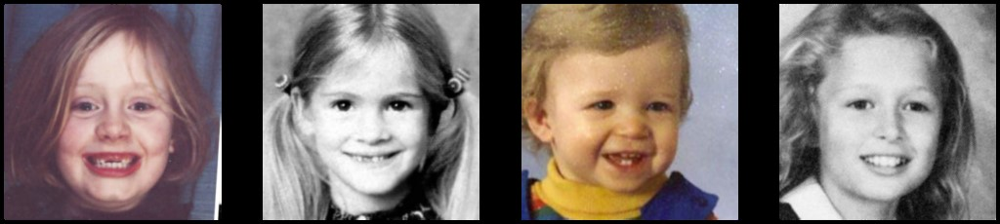
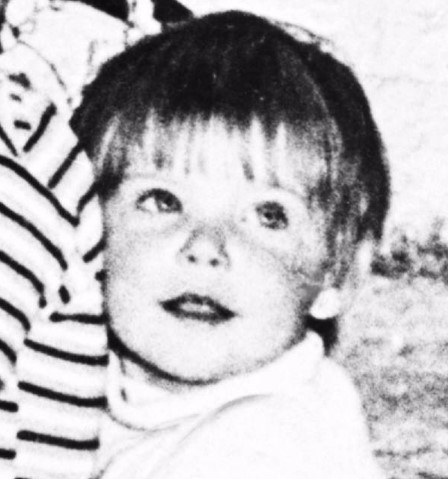
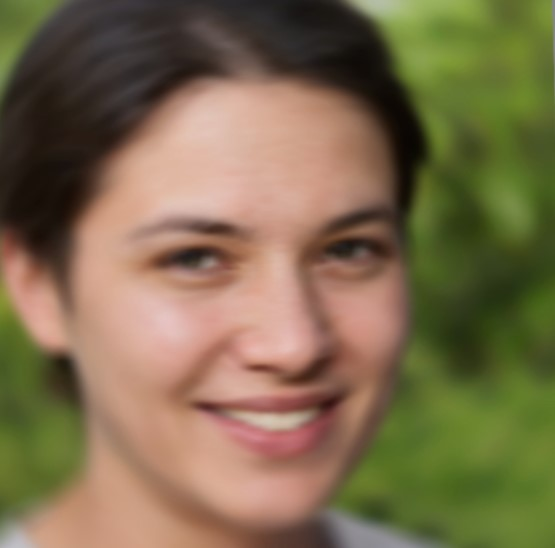
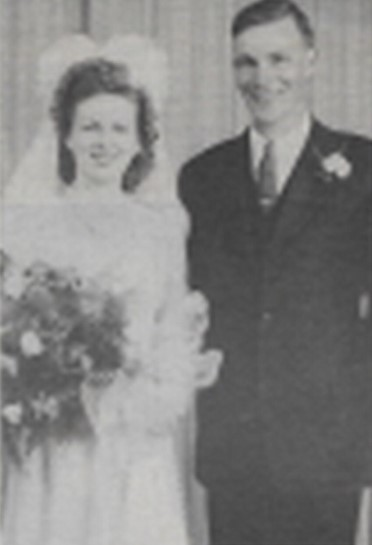
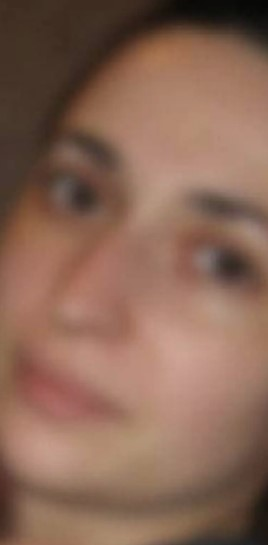
...
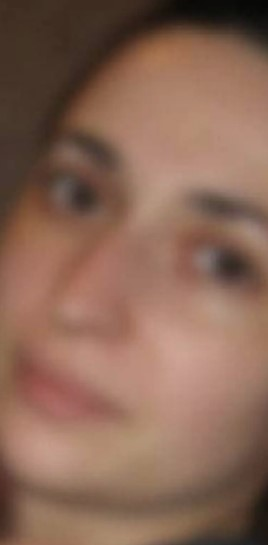
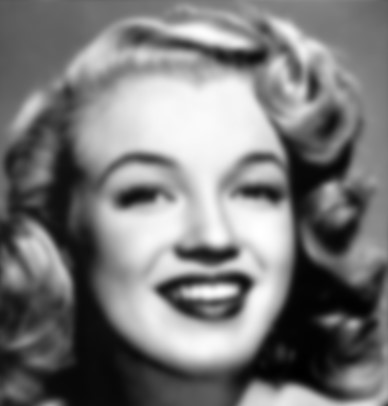
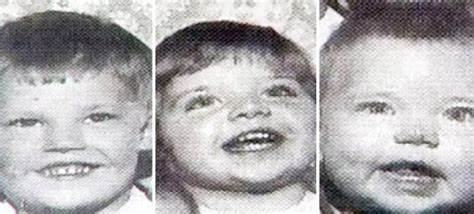
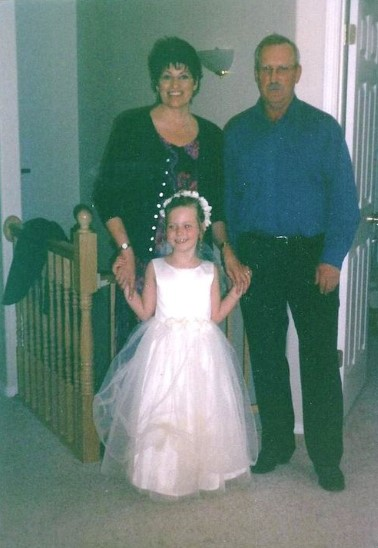
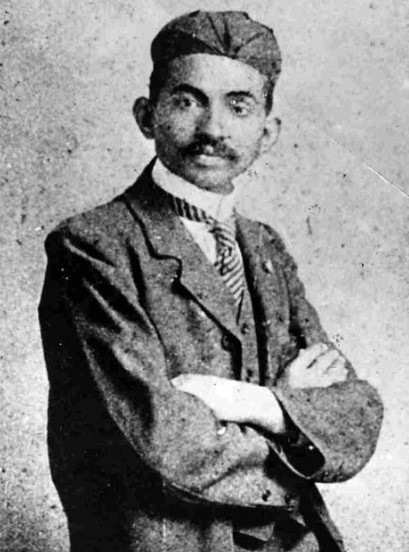

In [18]:
multiple_images(upload_folder, img_width=150, max_images=15)

## 6. Running the GAN model

Now we use the GFPGAN to restore the above low-quality images
We use [Real-ESRGAN](https://github.com/xinntao/Real-ESRGAN) for enhancing the background (non-face) regions

**Usage: python inference_gfpgan.py -i inputs/whole_imgs -o results -v 1.3 -s 2 [options]...**
 
  **-h**                   show this help<br>
  **-i input**             Input image or folder. Default: inputs/whole_imgs<br>
  **-o output**            Output folder. Default: results<br>
  **-v version**           GFPGAN model version. Option: 1 | 1.2 | 1.3. Default: 1.3<br>
  **-s upscale**           The final upsampling scale of the image. Default: 2<br>
  **-bg_upsampler**        background upsampler. Default: realesrgan<br>
  **-bg_tile**             Tile size for background sampler, 0 for no tile during testing. Default: 400<br>
  **-suffix**              Suffix of the restored faces<br>
  **-only_center_face**    Only restore the center face<br>
  **-aligned**            Input are aligned faces<br>
  **-ext**                 Image extension. Options: auto | jpg | png, auto means using the same extension as inputs. Default: auto<br>


In [19]:
t1 = time.time()
print("Running the GFPGAN model to restore the images...\n")

print("Deleting any previous results")
!rm -rf results
print("Done")

print("\nRunning the GFPGAN model\n")
!python inference_gfpgan.py -i inputs/upload -o results -v 1.4 -s 2 --bg_upsampler realesrgan
print("Done")

print("\nResults:\n")
!ls results/cmp

print("\nDone in", round((time.time() - t1)), "seconds")

Running the GFPGAN model to restore the images...

Deleting any previous results
Done

Running the GFPGAN model

/anaconda/envs/azureml_py38/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Processing image (1).jpg ...
	Tile 1/3
	Tile 2/3
	Tile 3/3
Processing image (2).jpg ...
	Tile 1/4
	Tile 2/4
	Tile 3/4
	Tile 4/4
Processing image (3).jpg ...
	Tile 1/4
	Tile 2/4
	Tile 3/4
	Tile 4/4
Processing image (4).jpg ...
	Tile 1/2
	Tile 2/2
Processing image (5).jpg ...
	Tile 1/2
	Tile 2/2
Processing image (6).jpg ...
	Tile 1/2
	Tile 2/2
Pr

## 7. Results

In [20]:
%%javascript

IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

In [21]:
input_folder = 'inputs/upload'  # Initial images
crop_folder = 'results/cropped_faces'  # Faces cropped images
result_folder = 'results/restored_faces'  # Restored faces images
restored_folder = 'results/restored_imgs'  # Full restored images

### 7.1 Viewing crop images

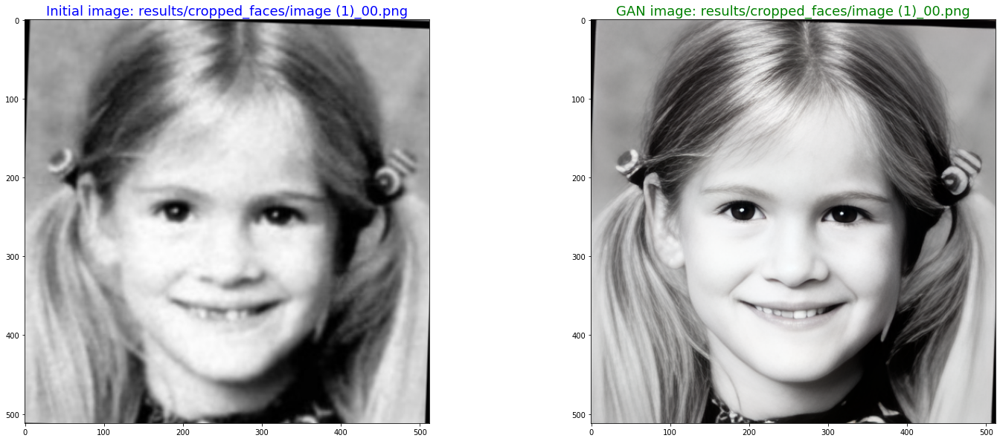

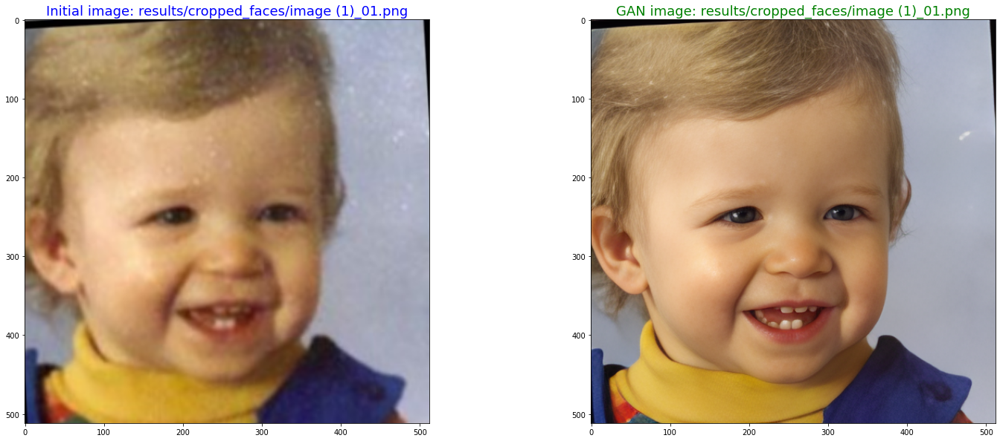

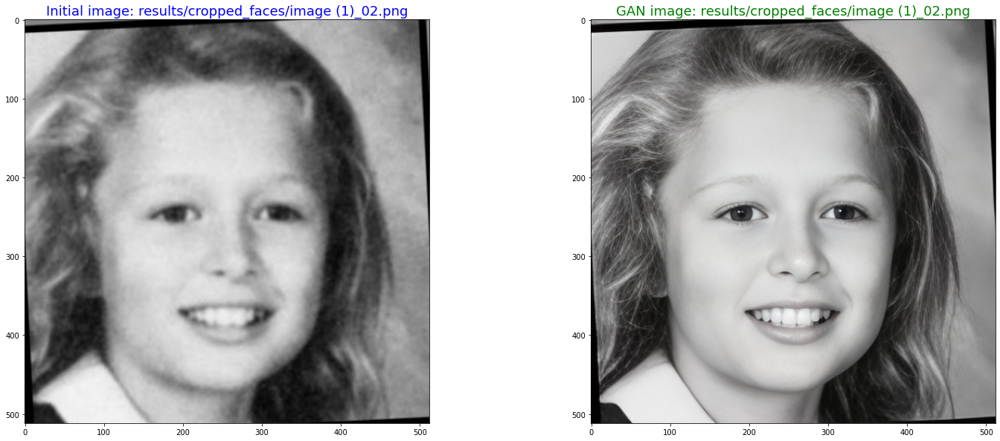

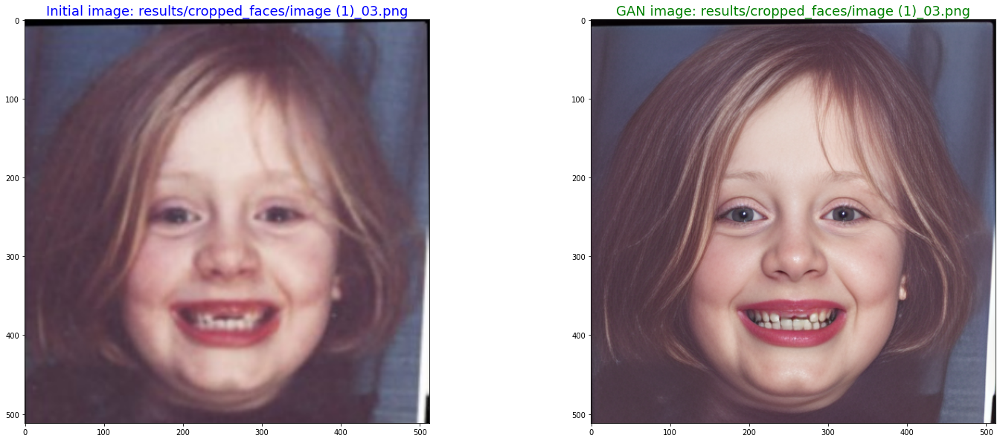

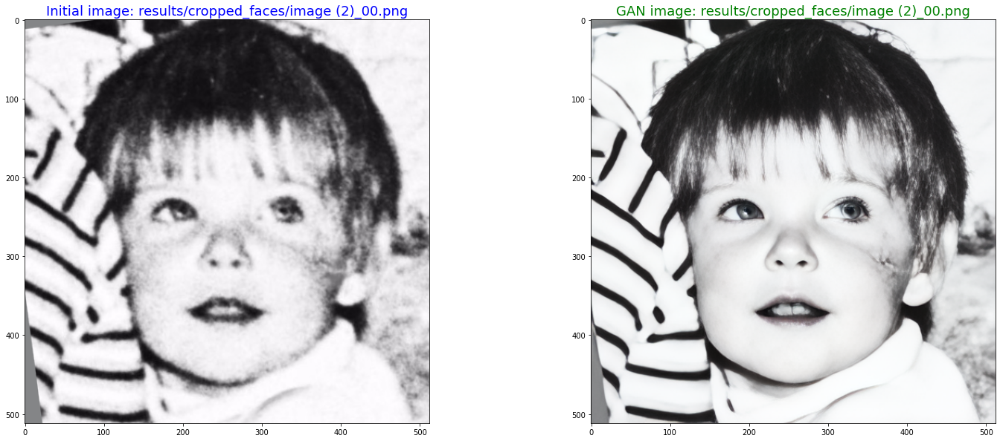

...

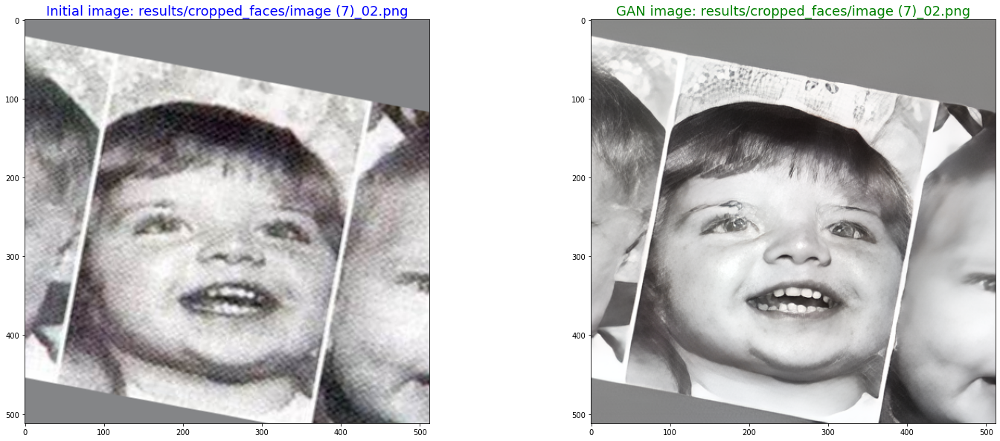

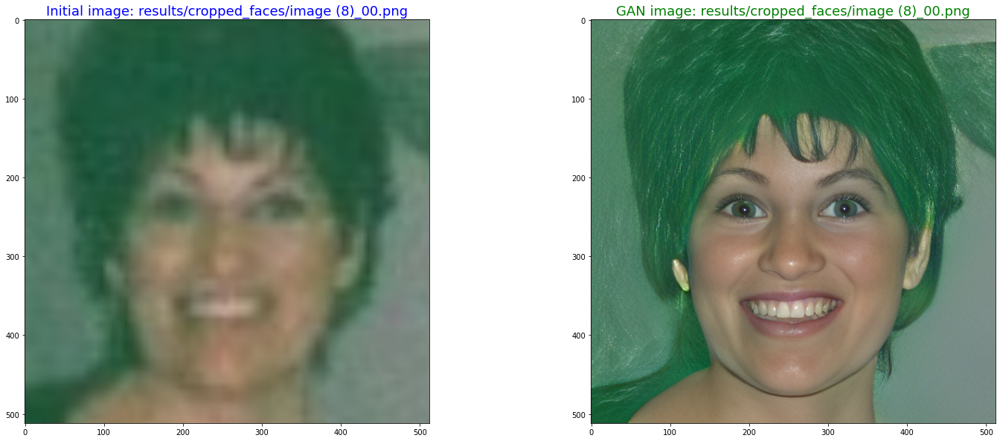

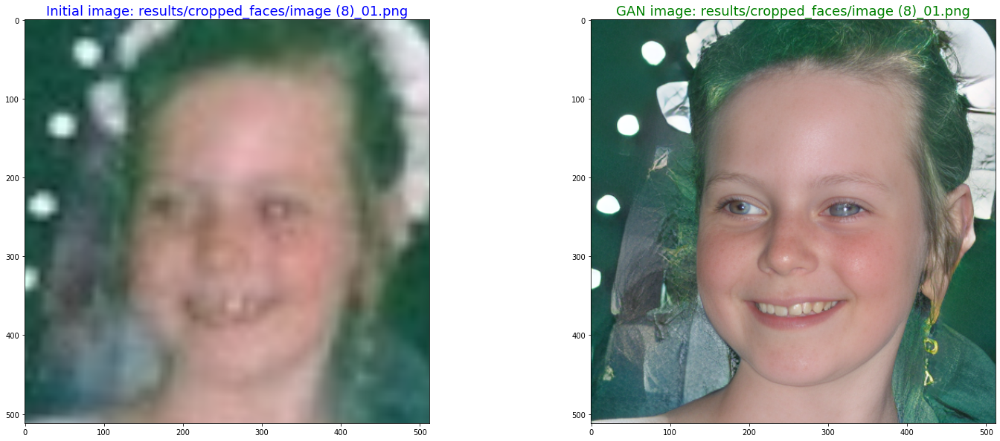

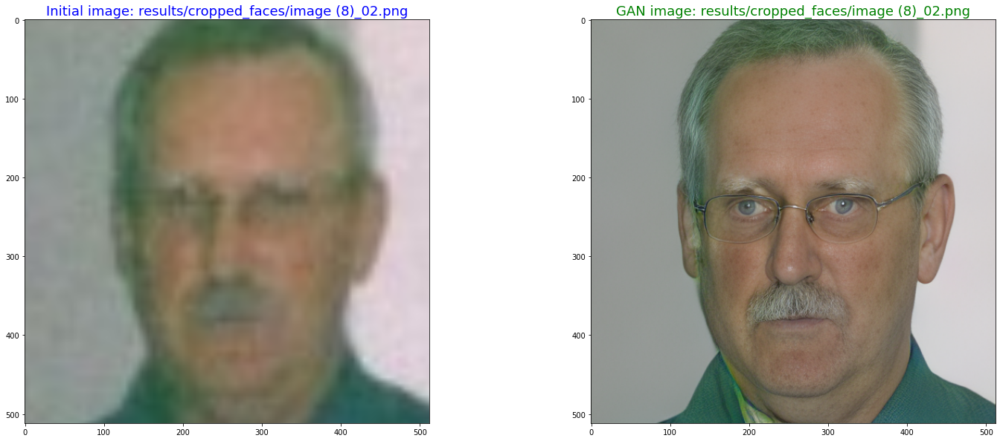

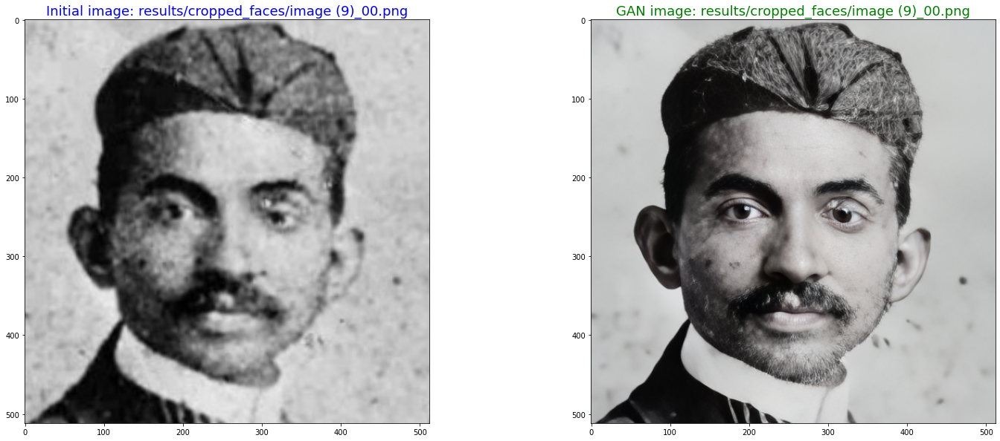

In [22]:
list_crop = sorted(glob.glob(os.path.join(crop_folder, '*')))
list_result = sorted(glob.glob(os.path.join(result_folder, '*')))

for idx1, idx2 in zip(list_crop, list_result):   
    comparing_images(idx1, idx2)

### 7.2 Viewing restored images

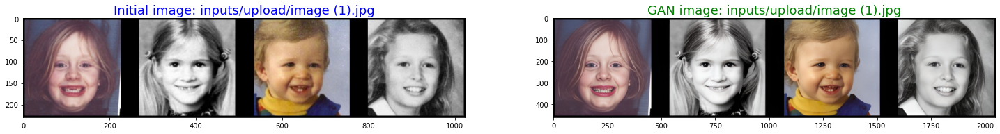

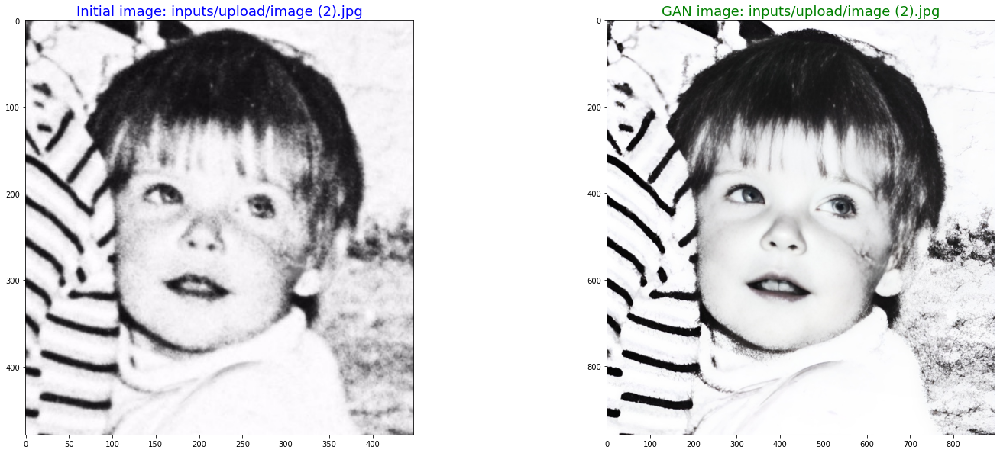

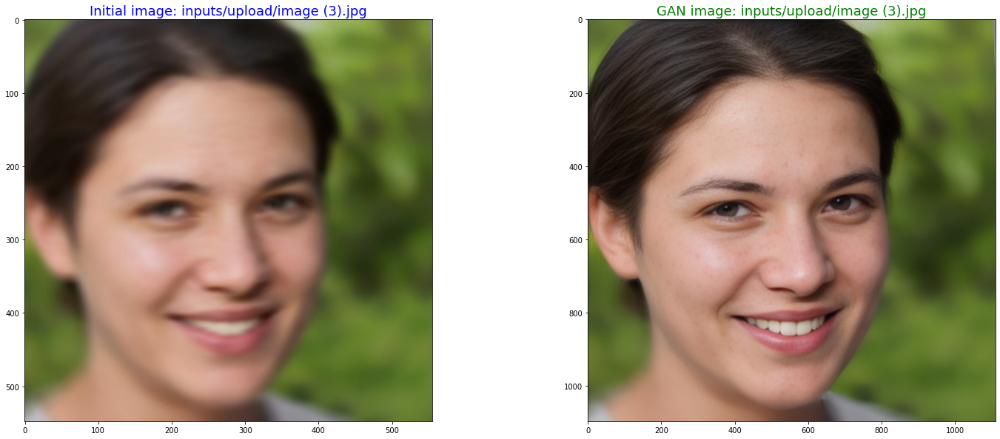

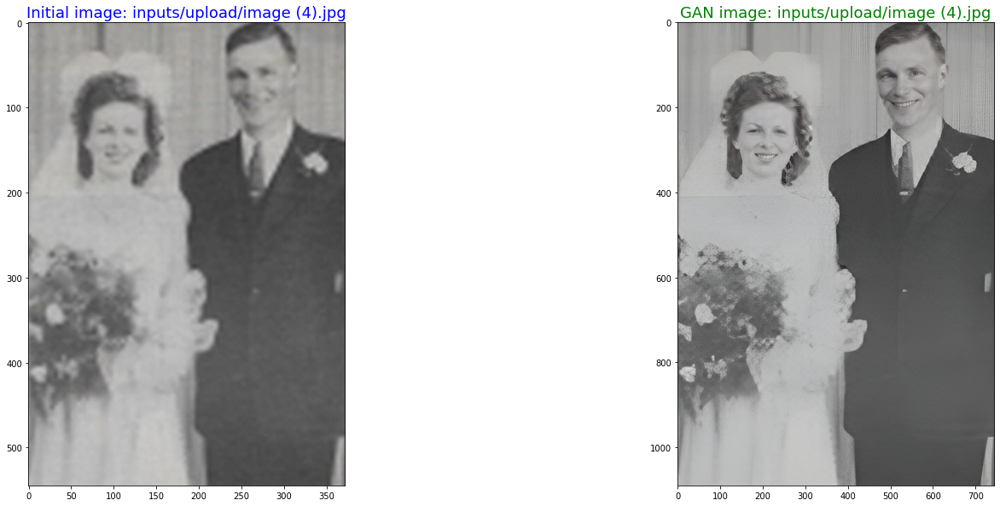

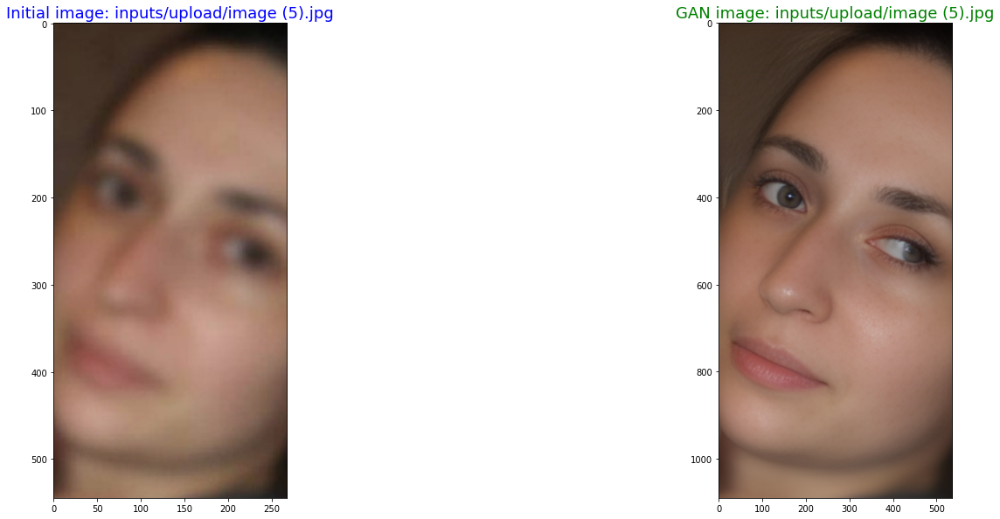

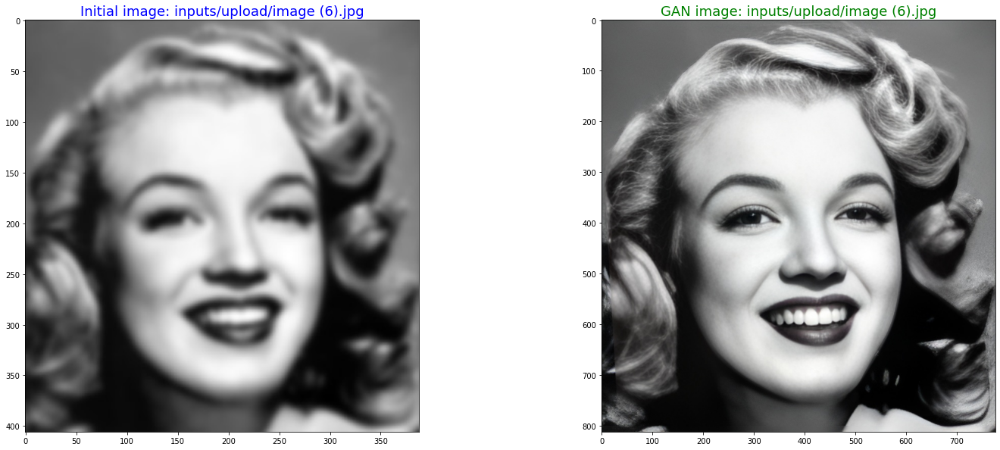

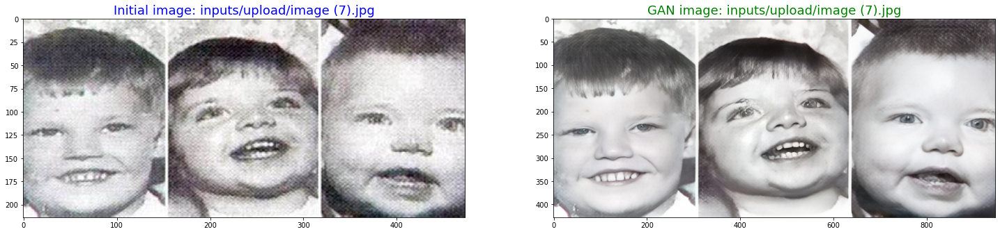

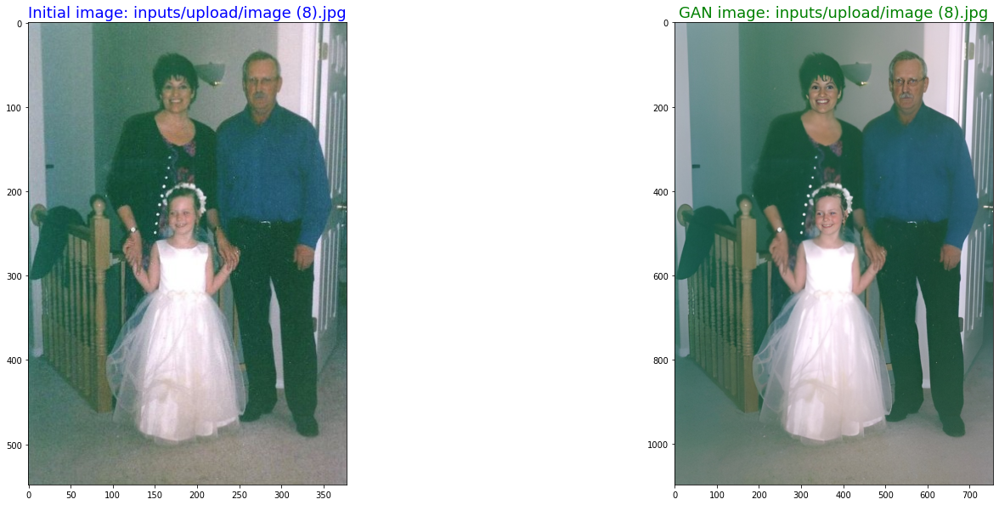

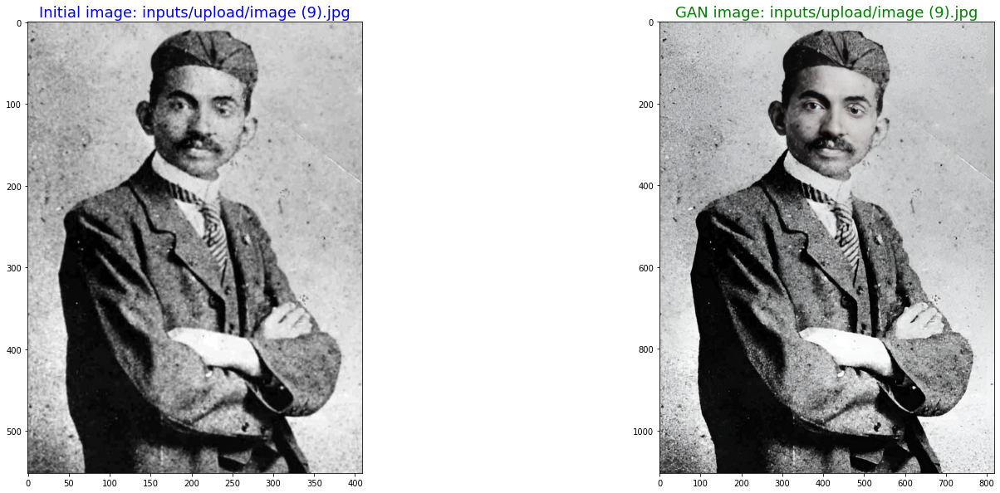

In [23]:
list_input = sorted(glob.glob(os.path.join(input_folder, '*')))
list_restored = sorted(glob.glob(os.path.join(restored_folder, '*')))

for idx1, idx2 in zip(list_input, list_restored):   
    comparing_images(idx1, idx2)

## 8. Zipping files

In [24]:
try:
    print("Zipping initial images files...")
    shutil.make_archive("../inital_images", "zip", upload_folder)
    print("Done")
    
except:
    print("[Error]")

Zipping initial images files...
Done


In [25]:
try:
    print("Zipping all generated GAN images files...")
    shutil.make_archive("../gan_results_images", "zip", "results")
    print("Done")
    
except:
    print("[Error]")

Zipping all generated GAN images files...
Done


In [26]:
os.chdir('..')
!ls *.zip -lh

-rwxrwxrwx 1 root root  22M Dec 22 10:04 gan_results_images.zip
-rwxrwxrwx 1 root root 310K Dec 22 10:04 inital_images.zip
